In [3]:
import re
import pandas as pd
import gensim.utils
import nltk
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from gensim.models import KeyedVectors
from bertopic import BERTopic
from top2vec import Top2Vec

import sys 
sys.path.append('/Users/jessicahassibi/PycharmProjects/bachelor-thesis/src/data') # replace with your absolute path
# import modules from another folder
import WikiScraper
import data_analysis

New WikiScraper initialized.


In [4]:
persecuted_composers_path = "../data/verfolgte_komponisten_texte.json" # path to save wikipedia texts to or load from if file already existing
df = data_analysis.get_composers_dataframe(persecuted_composers_path)
df.head()

Texts have already been scraped to: ../data/verfolgte_komponisten_texte.json


,de_title,en_title,ar_title,fr_title,it_title,es_title,de_paragraphs,en_paragraphs,ar_paragraphs,fr_paragraphs,it_paragraphs,es_paragraphs,de_categories,en_categories,ar_categories,fr_categories,it_categories,es_categories
1,Abel Ehrlich,Abel Ehrlich,أبيل إرليخ,Abel Ehrlich,,,"[Ehrlich, aufgewachsen in einer deutschen jüdi...","[Erlich was born in 1915 in Cranz, East Prussi...",[أبيل إرليخ على موقع المكتبة المفتوحة (الإنجلي...,"[Erlich naît à Cranz, en Prusse-Orientale. En ...",,,"[Kategorie:Deutscher, Kategorie:Geboren 1915, ...","[Category:1915 births, Category:2003 deaths, C...","[تصنيف:أشخاص من زيلينوغرادسك, تصنيف:أشخاص من ش...",[Catégorie:Article de Wikipédia avec notice d'...,,
2,Admiral Horthy,Miklós Horthy,ميكلوش هورتي,Miklós Horthy,Miklós Horthy,Miklós Horthy,[Horthy stammte aus einer in der Großen Ungari...,[Miklós Horthy de Nagybánya was born at Kender...,[ميكلوش هورتي على موقع Encyclopædia Britannica...,"[Après la guerre, la république fédérative pop...",[Horthy nacque in una cittadina nell'attuale p...,[Pál Teleki Gyula Gömbös István Bethlen Primer...,"[Kategorie:Adliger, Kategorie:Autobiografie, K...","[Category:1868 births, Category:1957 deaths, C...","[تصنيف:أخطاء CS1: التاريخ, تصنيف:أشخاص مجريون ...","[Catégorie:Amiral autrichien, Catégorie:Anti-m...","[Categoria:Aggiungere sezioni - militari, Cate...","[Categoría:Anticomunistas de Hungría, Categorí..."
3,Alexander von Zemlinsky,Alexander von Zemlinsky,ألكسندر فون زيميلنسكي,Alexander von Zemlinsky,Alexander von Zemlinsky,Alexander von Zemlinsky,"[Stefan Schmidl: Zemlinsky, Alexander von. In:...",[Zemlinsky's best-known work is the Lyric Symp...,[ألكسندر فون زيميلنسكي على موقع Encyclopædia B...,[Zemlinsky étudie au conservatoire de Vienne o...,[Quintetto d'archi 1896 6 quartetti per archi ...,"[El padre de Alexander, Adolf, provenía de una...","[Kategorie:Alexander von Zemlinsky, Kategorie:...","[Category:1871 births, Category:1942 deaths, C...","[تصنيف:بذرة مؤلف نمساوي, تصنيف:بروتستانت نمساو...",[Catégorie:Article de Wikipédia avec notice d'...,"[Categoria:Austriaci del XIX secolo, Categoria...","[Categoría:Alexander Zemlinsky, Categoría:Comp..."
4,Alexandre Tansman,Alexandre Tansman,,Alexandre Tansman,Alexandre Tansman,Alexandre Tansman,[Tansman wurde in Łódź als Sohn jüdischer Elte...,[Tansman was born and raised in the Polish cit...,,[Né à Łódź le 11 juin 1897 dans une famille de...,"[Tansman nacque a Łódź, in Polonia, nel 1897. ...",[Sus primeros años transcurrieron en su Poloni...,"[Kategorie:Ehrendoktor einer Hochschule, Kateg...","[Category:1897 births, Category:1986 deaths, C...",,[Catégorie:Article de Wikipédia avec notice d'...,"[Categoria:BioBot, Categoria:Compositori class...",[Categoría:Compositores de música clásica de F...
5,Alfons Josef Biron,,,,,,[],,,,,,[],,,,,


In [6]:
####################################################################################################################################
####################################################################################################################################
# Topic Modeling
# merge texts together for each language
de_documents = df.de_paragraphs.values.tolist()
en_documents = df.en_paragraphs.values.tolist()
ar_documents = df.ar_paragraphs.values.tolist()
fr_documents = df.fr_paragraphs.values.tolist()
es_documents = df.es_paragraphs.values.tolist()
it_documents = df.it_paragraphs.values.tolist()
multilingual_documents = []

for language_documents in [de_documents, en_documents, ar_documents, fr_documents, es_documents, it_documents]:
    for documents in language_documents:
        for document in documents:
            if document == "":
                continue
            multilingual_documents.append(document)

In [7]:
# Getting sentences from text
multilingual_all_sentences = []
for document in multilingual_documents:
    sentences = nltk.sent_tokenize(document)
    for sentence in sentences:
        multilingual_all_sentences.append(sentence)

In [45]:
####################################################################################################################################
# Using Top2Vec 
# distiluse-base-multilingual-cased pre-trained sentence transformer recommended for multilingual datasets
# embedding_model='distiluse-base-multilingual-cased' is sentence transformer model!
# no specified will use doc2vec method -> not multilingual
# no need to remove stop words
top2vec_model = Top2Vec(multilingual_documents, verbose=True, min_count=10, ngram_vocab=True, embedding_model='distiluse-base-multilingual-cased')
top2vec_model.save("../models/Top2Vec_model")

2022-06-16 23:50:00,594 - top2vec - INFO - Pre-processing documents for training
2022-06-16 23:50:02,801 - top2vec - INFO - Downloading distiluse-base-multilingual-cased model
2022-06-16 23:50:12,753 - top2vec - INFO - Creating joint document/word embedding
2022-06-17 13:31:18,703 - top2vec - INFO - Creating lower dimension embedding of documents
2022-06-17 14:02:45,264 - top2vec - INFO - Finding dense areas of documents
2022-06-17 14:02:45,331 - top2vec - INFO - Finding topics


In [10]:
top2vec_model = Top2Vec.load("../models/Top2Vec_model")
top2vec_model.get_num_topics()

33

In [11]:
topic_sizes, topic_nums = top2vec_model.get_topic_sizes()
print(topic_nums)
print(topic_sizes)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32]
[984 335 281 179 157 127 120  97  89  89  84  76  75  74  71  70  68  67
  65  59  52  46  45  44  41  40  36  35  33  32  31  30  22]


In [12]:
words, word_scores = top2vec_model.similar_words(keywords=["Schonberg"], keywords_neg=[], num_words=20) 
for word, score in zip(words, word_scores):
    print(f"{word} {score}")

prieberg 0.9570821172649859
schonbergs 0.9385188526492155
hirshberg 0.9016079332939221
schonberg anton 0.8873409502742061
fitelberg 0.8801852610735371
schoenberg 0.8789182154892871
tyberg 0.8788928213066066
weinberg 0.8732061529563491
konigsberg 0.8649150769751737
glanzberg 0.8590821157615026
nurnberg 0.8389900941851227
nuremberg 0.8239943199741366
weinberger 0.817519709636843
bernstein 0.8151905172127185
heidelberg 0.8009239445424772
du mont 0.7984006661544569
lemberg 0.7967666693306161
berg 0.7932036200775856
goldberg 0.7898105471210923
jehoash hirshberg 0.7851626055572085


None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None


/Users/jessicahassibi/opt/anaconda3/envs/thesis-test2/lib/python3.9/site-packages/top2vec/Top2Vec.py:2697: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(16, 4),


None
None
None
None
None
None
None
None
None
None
None
None
None


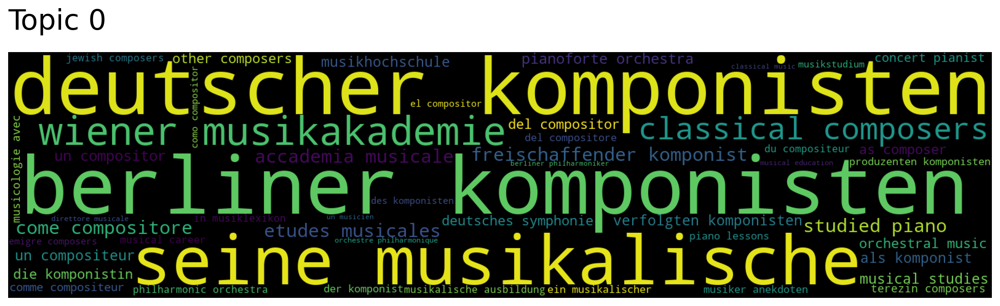

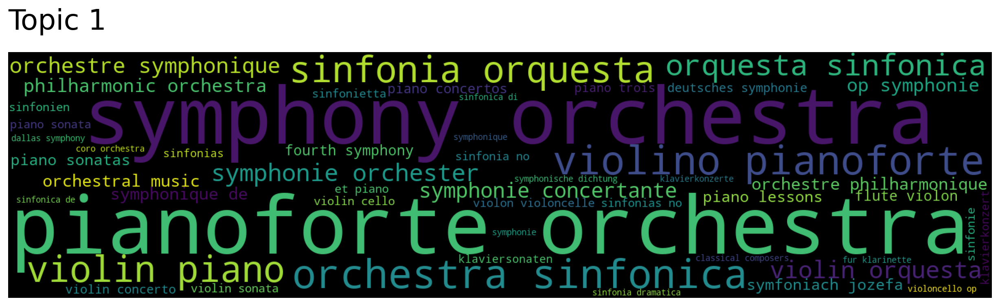

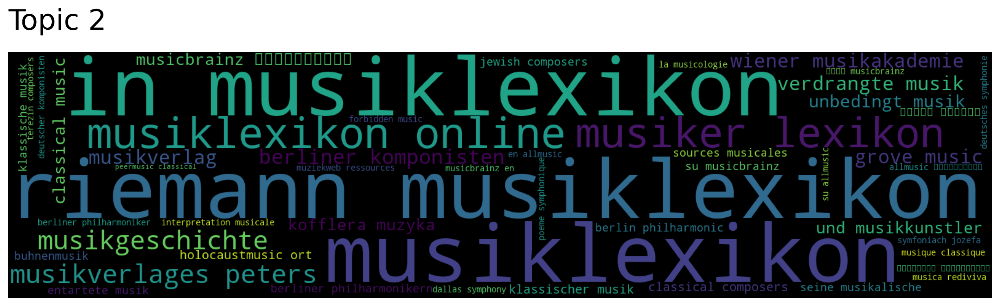

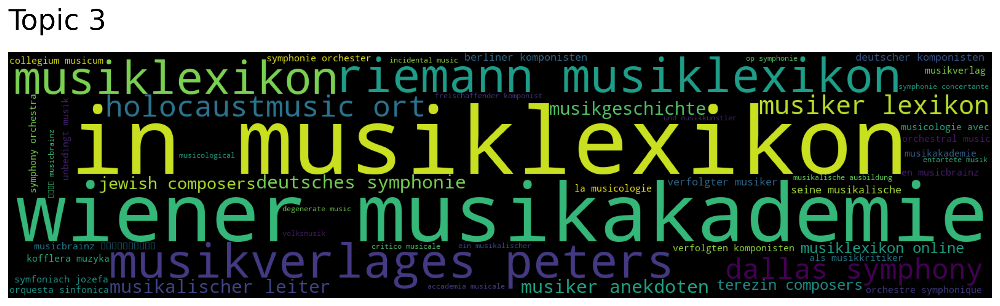

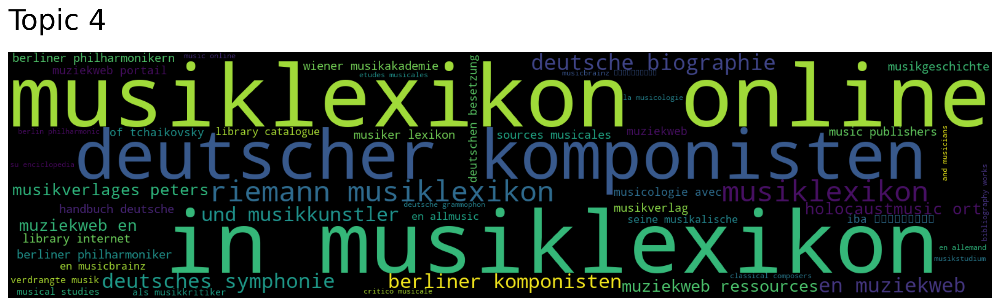

...

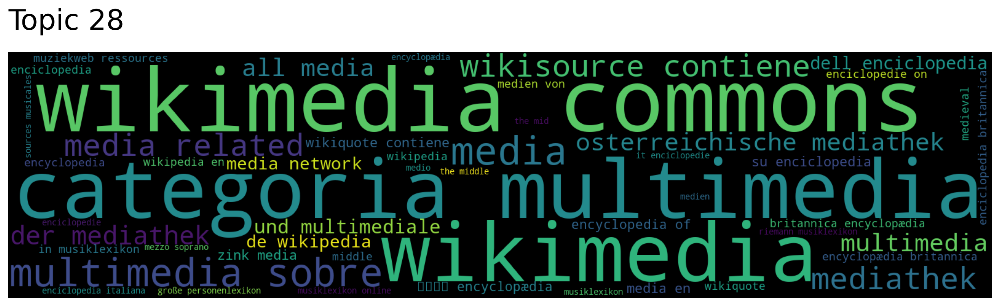

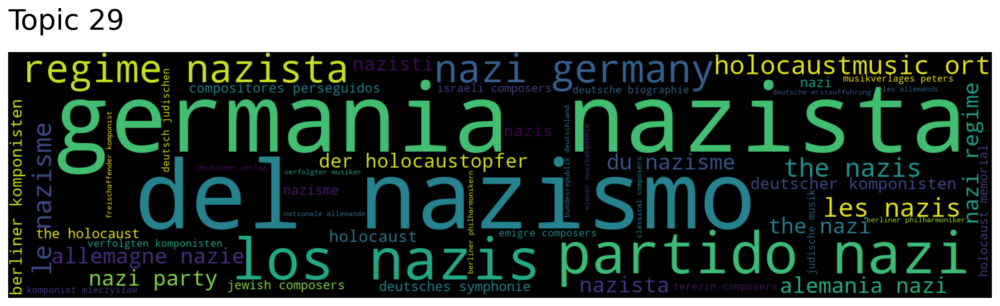

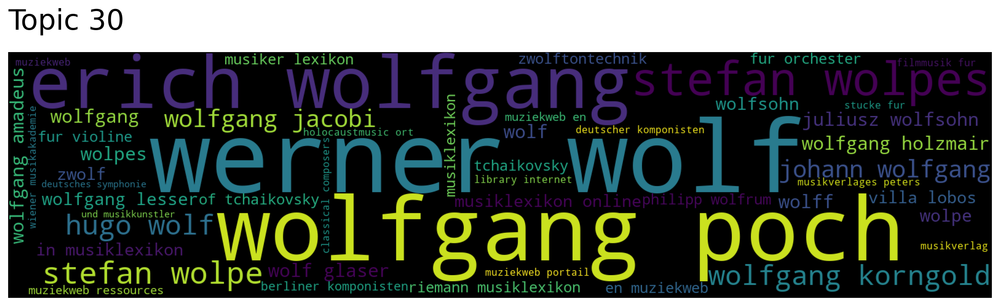

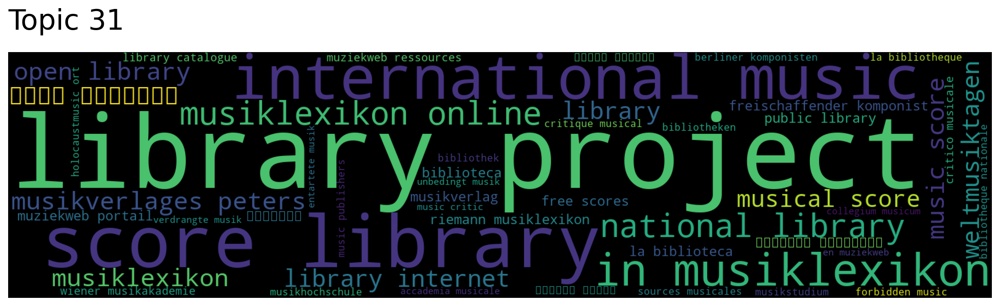

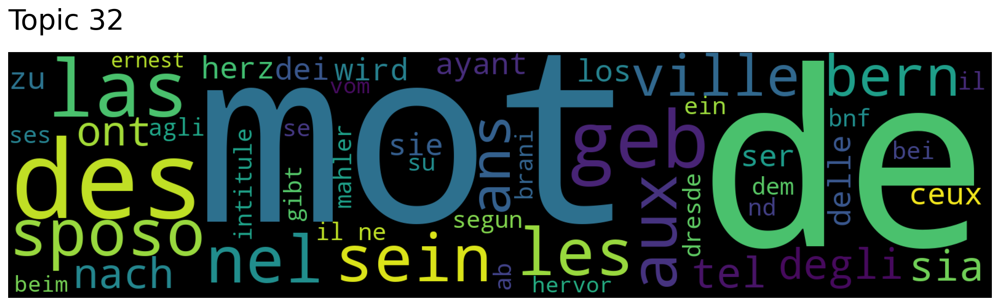

In [13]:
for topic in range(top2vec_model.get_num_topics()):
    print(top2vec_model.generate_topic_wordcloud(topic))

In [14]:
####################################################################################################################################
# Using BERTopic
# Train model on documents with mixed languages

# merge stopwords for each language
stop_words = stopwords.words('german') + stopwords.words('english') + stopwords.words('arabic') + stopwords.words('french') + stopwords.words('italian') + stopwords.words('spanish')

In [9]:
# language="multilingual" results in using sentence-transformers model "paraphrase-multilingual-MiniLM-L12-v2"
vectorizer_model = CountVectorizer(ngram_range=(1, 2), stop_words=stop_words)
topic_model = BERTopic(verbose=True, language="multilingual", vectorizer_model=vectorizer_model) # use min_topic_size=40 for less topics
topics, probs = topic_model.fit_transform(multilingual_documents)
topic_model.save("../models/BERTopic_model_multilingual")

# Update topic representations to try different parameters
#topic_model.update_topics(multilingual_documents, topics, vectorizer_model=cv)

Batches:   0%|          | 0/115 [00:00<?, ?it/s]

2022-06-28 17:57:23,369 - BERTopic - Transformed documents to Embeddings
2022-06-28 17:57:36,275 - BERTopic - Reduced dimensionality
2022-06-28 17:57:36,375 - BERTopic - Clustered reduced embeddings


In [15]:
topic_model = BERTopic.load("../models/BERTopic_model_multilingual")

In [16]:
topic_model.get_topic_info()

,Topic,Count,Name
0,-1,811,-1_music_isbn_musik_eisler
1,0,581,0_wurde_berlin_music_1933
2,1,484,1_op_piano_orchestra_klavier
3,2,298,2_isbn_band_verlag_isbn 978
4,3,85,3_preis_stadt_prize_stadt wien
5,4,80,4_internet_database_movie database_movie
6,5,64,5_commons contiene_immagini altri_immagini_con...
7,6,62,6_portail_musique_ressources relatives_relatives
8,7,57,7_ebrei_jewish_ebraica_ebraico
9,8,56,8_compositeurs_liste compositeurs_persécutés_p...


In [17]:
topic_model.visualize_topics()

In [24]:
topic_model.transform("Schönberg")

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

([-1], array([0.]))

In [35]:
for i in range(len(topic_model.get_topic_info())):
    print(f"Thema {i-1}")
    list = topic_model.get_topic(i-1)
    for elem in list:
        print(elem)
    print()

Thema -1
('music', 0.006818573183649472)
('isbn', 0.006469256199708331)
('musik', 0.005436568032335372)
('eisler', 0.0050754846656649345)
('regia', 0.004824539410410203)
('berlin', 0.004424022161761689)
('com', 0.0037751182777891255)
('new', 0.003753717207400001)
('978', 0.0036374524726502286)
('wien', 0.0036270941265348655)

Thema 0
('wurde', 0.008481276168976037)
('berlin', 0.005350558267650811)
('music', 0.005095874988162691)
('1933', 0.004214877883179955)
('composition', 0.003971361991540773)
('vienna', 0.003938573833770671)
('musik', 0.0037359130191636112)
('1938', 0.00372918403387376)
('ab', 0.003641045265850926)
('new', 0.003632663895271024)

Thema 1
('op', 0.018770912105486405)
('piano', 0.015415738280925632)
('orchestra', 0.010473700118012933)
('klavier', 0.007494705145499493)
('orchestre', 0.006411893250681454)
('symphonie', 0.00617472989712587)
('concerto', 0.006123664518409088)
('suite', 0.005861913558114105)
('string', 0.005244962218219017)
('orchester', 0.0049778779191849